In [372]:
import numpy as np
import matplotlib.pyplot as plt
import math
from scipy.sparse import diags
from matplotlib import cm
from matplotlib.ticker import LinearLocator
from numpy.linalg import inv
import scipy.stats as si
from scipy.stats import norm
import sympy as sy
from mpl_toolkits.mplot3d import Axes3D

In [373]:
#use matrix
def FTCS_Schemes(S0=100, K=110, T=1, sigma=0.3,r=0.04,Smin=np.exp(-5),Smax=np.exp(8),i=1000, n=1000):
    X0=math.log(S0)
    Xmax =math.log(Smax)
    Xmin =math.log(Smin)
    u = np.zeros((i+1, n+1))
    x_values = np.linspace(Xmin, Xmax, i+1)
    dx = (Xmax-Xmin)/ float(i)  
    dtau = T / float(n)
    tau_index=np.arange(1,n+1)
    # Set up boundaries 
    u[:, 0] = np.maximum(np.exp(x_values) - K, 0)
    u[-1, 1:] = np.exp(Xmax)
    u[0,1:]=0
    a = -(2 * r - sigma**2) * dtau / (4 * dx)+sigma**2 * dtau / (2 * dx**2)
    b = 1-r * dtau - sigma**2 * dtau / (dx**2)
    c = (2 * r - sigma**2) * dtau / (4 * dx)+sigma**2 * dtau / (2 * dx**2)
    A = np.diag([a for i in range(i-2)], -1) + \
        np.diag([b for i in range(i-1)]) + \
        np.diag([c for i in range(i-2)], 1)  
    for t in tau_index:
        K_right=np.zeros(i-1)
        K_right[-1]=c*u[-1,t-1]
        u[1:i,t] = A.dot(u[1:i,t-1])+ K_right
    valuelist = [np.interp(math.log(100), x_values, u[:, -1]),np.interp(math.log(110), x_values, u[:, -1]),np.interp(math.log(120), x_values, u[:, -1])]
    return valuelist,u,np.exp(x_values)

In [374]:
def CN_Schemes(S0=100, K=110, T=1, sigma=0.3,r=0.04,Smin=np.exp(-5),Smax=np.exp(8),i=1000, n=1000):
    X0=math.log(S0)
    Xmax =math.log(Smax)
    Xmin =math.log(Smin)
    u = np.zeros((i+1, n+1))
    x_values = np.linspace(Xmin, Xmax, i+1)
    dx = (Xmax-Xmin)/ float(i)
    dtau = T / float(n)
    tau_index=np.arange(1, n+1)
    # Set up boundaries 
    u[:, 0] = np.maximum(np.exp(x_values) - K, 0)
    u[-1, 1:] = np.exp(Xmax)
    u[0,:]=0
    a0= -(2 * r - sigma**2) * dtau / (8 * dx)+sigma**2 * dtau / (4 * dx**2)
    a1= 1-sigma**2 * dtau / (2 * dx**2)-r*dtau/2
    a2=(2 * r - sigma**2) * dtau / (8 * dx)+sigma**2 * dtau / (4 * dx**2)
    b0=(2 * r - sigma**2) * dtau / (8 * dx)- sigma**2 * dtau / (4 * dx**2)
    b1=1+ sigma**2 * dtau / (2 * dx**2)+r*dtau/2
    b2=-(2 * r - sigma**2) * dtau / (8 * dx)-sigma**2 * dtau / (4 * dx**2)
    A = np.diag([a0 for i in range(i-2)], -1) + \
        np.diag([a1 for i in range(i-1)]) + \
        np.diag([a2 for i in range(i-2)], 1)     
    B = np.diag([b0 for i in range(i-2)], -1) + \
        np.diag([b1 for i in range(i-1)]) + \
        np.diag([b2 for i in range(i-2)], 1)
    B_inv = np.linalg.inv(B)
    for t in tau_index:
        K_left=np.zeros(i-1)
        K_left[0]=0
        K_left[-1]=b2*u[-1,t]
        K_right=np.zeros(i-1)
        K_right[0]=0
        K_right[-1]=a2*u[-1,t-1]
        u[1:i,t] = B_inv.dot(A.dot(u[1:i,t-1]) + K_right - K_left)
    valuelist = [np.interp(math.log(100), x_values, u[:, -1]),np.interp(math.log(110), x_values, u[:, -1]),np.interp(math.log(120), x_values, u[:, -1])]
    return valuelist,u,np.exp(x_values)
 

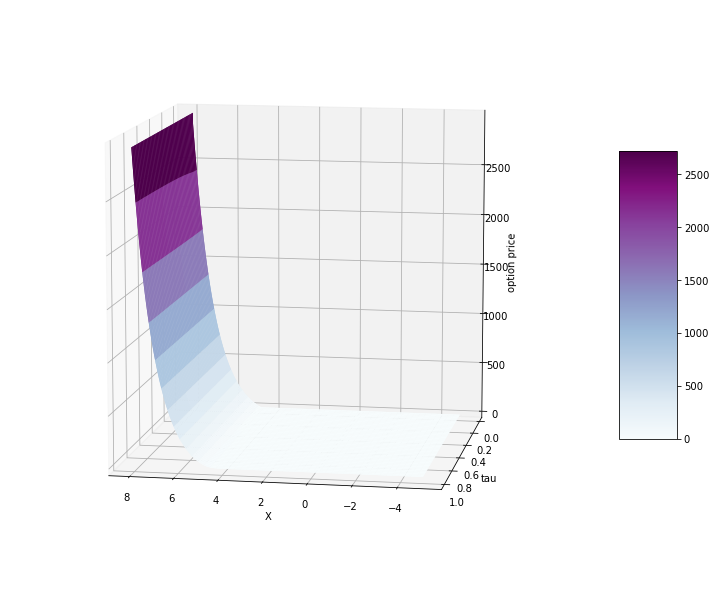

In [375]:
#3d plot of FTCS
grid=FTCS_Schemes(S0=100, K=110, T=1, sigma=0.3,r=0.04,Smin=np.exp(-5),Smax=np.exp(8),i=1000, n=1000)[1]
fig = plt.figure(figsize=(10,8))
ax = Axes3D(fig)
t,X= np.meshgrid(np.linspace(0, 1, 1001),np.linspace(-5,8,1001)[0:])
surf=ax.plot_surface(X,t, grid, cmap='BuPu')
ax.plot_surface(X,t, grid, cmap='BuPu')
ax.view_init(10,100)
ax.set_xlabel('X')
ax.set_ylabel('tau')
ax.set_zlabel('option price')
fig.colorbar(surf, shrink=0.5, aspect=5)
plt.savefig("3D plot of FTCS scheme",dpi=400)
plt.title('')
plt.show()

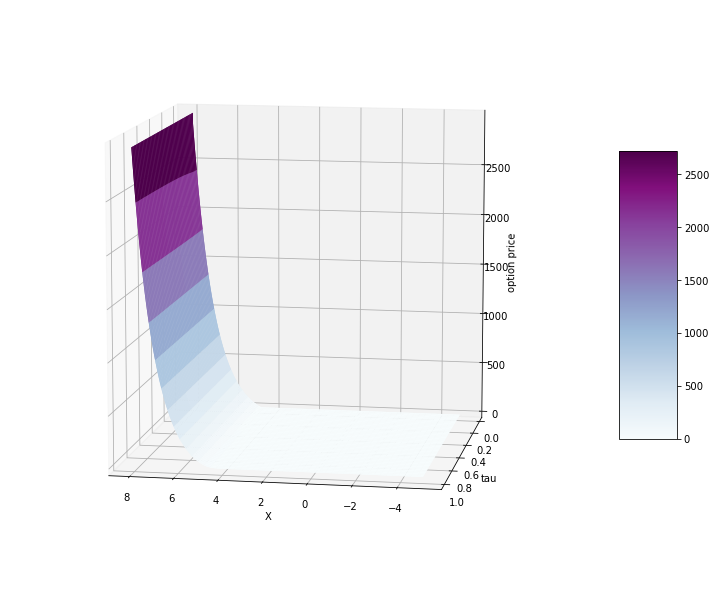

In [376]:
#3d plot of CN
grid=CN_Schemes(S0=100, K=110, T=1, sigma=0.3,r=0.04,Smin=np.exp(-5),Smax=np.exp(8),i=1000, n=1000)[1]
fig = plt.figure(figsize=(10,8))
ax = Axes3D(fig)
t,X= np.meshgrid(np.linspace(0, 1, 1001),np.linspace(-5,8,1001)[0:])
surf=ax.plot_surface(X,t, grid, cmap='BuPu')
ax.plot_surface(X,t, grid, cmap='BuPu')
ax.view_init(10,100)
ax.set_xlabel('X')
ax.set_ylabel('tau')
ax.set_zlabel('option price')
fig.colorbar(surf, shrink=0.5, aspect=5)
plt.savefig("3D plot of CN scheme",dpi=400)
plt.title('')
plt.show()

In [378]:
#BS option price
def BSmodel(S0,K=110,T=1,r=0.04,sigma=0.3,option_type="call"):
    d1=(np.log(S0/K)+(r + 0.5 * sigma ** 2) * T)/(sigma*np.sqrt(T))
    d2=d1-sigma*np.sqrt(T)
    if option_type=="call":
        option_price=S0*norm.cdf(d1)-K*np.exp(-r*T)*norm.cdf(d2)
    elif option_type=="put":
        option_price=K*np.exp(-r*T)*norm.cdf(-d2)-S0*norm.cdf(-d1)
    return option_price

In [379]:
BS1=BSmodel(S0=100)
BS2=BSmodel(S0=110)
BS3=BSmodel(S0=120)
FTCS=FTCS_Schemes(S0=100, K=110, T=1, sigma=0.3,r=0.04,Smin=np.exp(-5),Smax=np.exp(8),i=1000, n=1000)[0]
CN=CN_Schemes(S0=100, K=110, T=1, sigma=0.3,r=0.04,Smin=np.exp(-5),Smax=np.exp(8),i=1000, n=1000)[0]
print(BS1,BS2,BS3)
print(FTCS)
print(CN)


9.625357828843697 15.128591111967928 21.788808338829327
[9.627768428640582, 15.132039291323142, 21.791449804095695]
[9.62639325222345, 15.130283302680075, 21.789756904329266]


In [296]:
def FDmesh_FTCS(S0,K,T,r,vol,M1,M2,Nx,Nt):
    # M1:minimum X; M2:maximum X; Nx:number of delta_x; Nt:number of delta_tau
    # Smin=e^(M1) should near zero; Smax=e^(M2) should be large enough
    delta_tau = T/Nt
    delta_x = (M2-M1)/Nx
    tau_index=np.arange(1, Nt+1)
    x_values = np.linspace(M1, M2, Nx+1)

    #test stability
    a=2*np.square(vol)*delta_tau/np.square(delta_x)+r*delta_tau
    if a>2:
        print("this dx and dt is not stable for FTCS theme")
    else:
        print("this setting is ok")

    #print(delta_x)
    alpha = -(r-0.5*vol**2)*delta_tau/(2*delta_x)+0.5*vol**2*delta_tau/(delta_x**2)
    beta = 1-vol**2*delta_tau/(delta_x**2)-r*delta_tau
    gamma = (r-0.5*vol**2)*delta_tau/(2*delta_x)+0.5*vol**2*delta_tau/(delta_x**2)

    # construct a matrix for the option value
    V=np.zeros((Nx+1,Nt+1))
    # boundary condition
    V[:,0]= [max(np.exp(i)-K,0) for i in x_values] # the first column of the matrix: V_M^{0}
    V[-1,1:]= np.exp(M2)  #the last row of the matrix: V_M^{n}
    V[0,1:]=0 # the first row of the matrix: V_0^{n}
    #print(V)

    diagnals=[[alpha for i in range(Nx-2)],[beta for i in range(Nx-1)],[gamma for i in range(Nx-2)]]
    A = diags(diagnals,[-1,0,1])
    A_matrix=A.toarray()
    #print(A_matrix)


    for i in tau_index:
        k=np.zeros(Nx-1) 
        k[-1]= gamma*V[-1,i-1]
        V[1:-1,i]=A_matrix.dot(V[1:-1,i-1])+k

    valuelist = [np.interp(np.log(100), x_values, V[:, -1]),np.interp(np.log(110), x_values, V[:, -1]),np.interp(np.log(120), x_values, V[:, -1])]

    return V,valuelist


In [297]:
def FDmesh_CN(S0,K,T,r,vol,M1,M2,Nx,Nt):
    # M1:minimum X; M2:maximum X; Nx:number of delta_x; Nt:number of delta_tau
    # Smin=e^(M1) should near zero; Smax=e^(M2) should be large enough

    delta_tau = T/Nt
    delta_x = (M2-M1)/Nx
    tau_index=np.arange(1, Nt+1)
    x_values = np.linspace(M1, M2, Nx+1)
    #print(delta_x)
    aminus1 = -(r-0.5*vol**2)*delta_tau/(4*delta_x)+0.5/2*vol**2*delta_tau/(delta_x**2)
    a0 = 1-0.5*vol**2*delta_tau/(delta_x**2)-r*delta_tau/2
    a1 = (r-0.5*vol**2)*delta_tau/(4*delta_x)+0.5/2*vol**2*delta_tau/(delta_x**2)

    bminus1 = (r-0.5*vol**2)*delta_tau/(4*delta_x)-0.5/2*vol**2*delta_tau/(delta_x**2)
    b0 = 1+0.5*vol**2*delta_tau/(delta_x**2)+r*delta_tau/2
    b1 = -(r-0.5*vol**2)*delta_tau/(4*delta_x)-0.5/2*vol**2*delta_tau/(delta_x**2)

    # construct a matrix for the option value
    V=np.zeros((Nx+1,Nt+1))
    # boundary condition
    V[:,0]= [max(np.exp(i)-K,0) for i in x_values] # the first column of the matrix: V_M^{0}
    V[-1,1:]= np.exp(M2)  #the last row of the matrix: V_M^{n}
    V[0,1:]=0 # the first row of the matrix: V_0^{n}
    #print(V)

    # construct the A matrix
    diagnals_1=[[aminus1 for i in range(Nx-2)],[a0 for i in range(Nx-1)],[a1 for i in range(Nx-2)]]
    A = diags(diagnals_1,[-1,0,1])
    A_matrix=A.toarray()
    #print(A_matrix)

    # construct the B matrix
    diagnals_2=[[bminus1 for i in range(Nx-2)],[b0 for i in range(Nx-1)],[b1 for i in range(Nx-2)]]
    B = diags(diagnals_2,[-1,0,1])
    B_matrix=B.toarray()
    #print(B_matrix)

    B_inv=inv(B_matrix)
    #print(B_inv)

    for i in tau_index:
        k=np.zeros(Nx-1) 
        k[-1]= a1*(V[-1,i-1]+V[-1,i])
        V[1:-1,i]=B_inv.dot(A_matrix.dot(V[1:-1,i-1])+k)
        valuelist = [np.interp(np.log(100), x_values, V[:, -1]),np.interp(np.log(110), x_values, V[:, -1]),np.interp(np.log(120), x_values, V[:, -1])]

    return V,valuelist


In [298]:
Xlist=np.arange(200,2000,10)
BS_analytical=BS_call(110,0.04,100,0.3,1)
FTCS_price=[FDmesh_FTCS(100,110,1,0.04,0.3,-5,8,i,1000)[1][0] for i in Xlist]
abs_error=abs(FTCS_price-BS_analytical)
print(abs_error)

this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting is ok
this setting

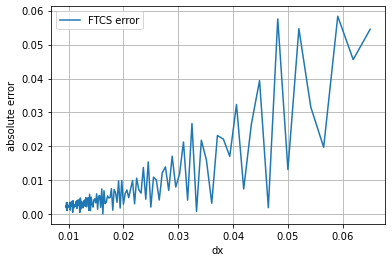

In [365]:
plt.plot(13/Xlist[0:118],abs_error[0:118],label="FTCS error")
plt.xlabel('dx')
plt.ylabel('absolute error')
plt.legend()
plt.grid()
plt.savefig("dx_ftcs_stable",dpi=400)
plt.show()

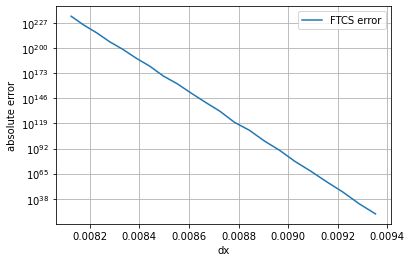

In [366]:
plt.semilogy(13/Xlist[119:141],abs_error[119:141],label="FTCS error")
plt.xlabel('dx')
plt.ylabel('absolute error')
plt.legend()
plt.grid()
plt.savefig("dx_ftcs_unstable",dpi=400)
plt.show()

In [330]:
CN_price=[FDmesh_CN(100,110,1,0.04,0.3,-5,8,i,1000)[1][0]for i in Xlist]
abs_error2=abs(CN_price-BS_analytical)
print(abs_error2)

[5.31409023e-02 4.42156062e-02 5.69762696e-02 1.84055441e-02
 3.02383824e-02 5.33205924e-02 1.45769361e-02 5.61885350e-02
 3.35818642e-03 3.80106306e-02 2.51911259e-02 6.09548560e-03
 3.09816416e-02 1.57092326e-02 2.07787779e-02 2.18390884e-02
 1.89035865e-03 1.46414810e-02 2.04605963e-02 2.27569059e-03
 2.53800215e-02 5.57080255e-03 1.99444051e-02 1.04837095e-02
 6.66427190e-03 1.57557083e-02 5.66863053e-03 1.25959346e-02
 1.08995613e-02 2.84668801e-03 8.76784129e-03 9.57985638e-03
 7.68751501e-04 1.40563450e-02 5.82359824e-03 1.24395266e-02
 4.87273898e-03 5.86726453e-03 9.31067492e-03 1.72765995e-03
 8.56772265e-03 6.08785138e-03 3.53687842e-03 5.79545374e-03
 4.75020514e-03 1.60711517e-03 8.62242677e-03 3.23131818e-03
 8.49461817e-03 2.17578596e-03 4.97463062e-03 5.93961204e-03
 1.56056890e-04 6.20369316e-03 3.53786179e-03 3.46625584e-03
 4.03016084e-03 2.22126260e-03 1.75514105e-03 5.57977815e-03
 1.24902223e-03 6.11490094e-03 6.86734350e-04 4.18841899e-03
 3.93355400e-03 1.165504

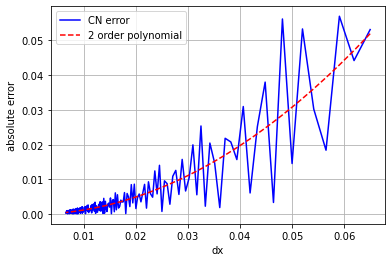

In [367]:
dx=13/Xlist
reg=np.polyfit(dx,abs_error2,2)
ry=np.polyval(reg,dx)
plt.plot(dx,abs_error2,'b',label='CN error')
plt.plot(dx,ry,'r--',label='2 order polynomial')
#plt.plot(13/Xlist,abs_error2,label='CN error')
plt.xlabel('dx')
plt.ylabel('absolute error')
plt.legend()
plt.grid()
plt.savefig("dx_cn_convergence",dpi=400)
plt.show()

In [338]:
Tlist=np.arange(200,2000,10)
FTCS_price2=[FDmesh_FTCS(100,110,1,0.04,0.3,-5,8,1300,i)[1][0]for i in Tlist]
CN_price2=[FDmesh_CN(100,110,1,0.04,0.3,-5,8,1300,i)[1][0]for i in Tlist]
t_error1=abs(FTCS_price2-BS_analytical)
t_error2=abs(CN_price2-BS_analytical)

this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for FTCS theme
this dx and dt is not stable for

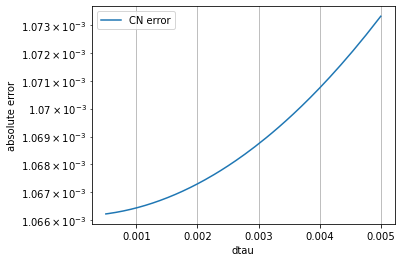

In [368]:
plt.semilogy(1/Tlist,t_error2,label='CN error')
plt.xlabel('dtau')
plt.ylabel('absolute error')
plt.legend()
plt.grid()
plt.subplots_adjust(left=0.2)
plt.savefig("dtau_cn",dpi=400)
plt.show()

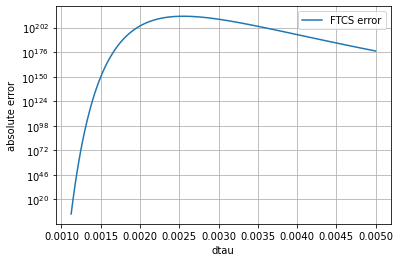

In [369]:
plt.semilogy(1/Tlist[0:70],t_error1[0:70],label='FTCS error')
plt.xlabel('dtau')
plt.ylabel('absolute error')
plt.legend()
plt.grid()
plt.savefig("dtau_ftcs_unstable",dpi=400)
plt.show()

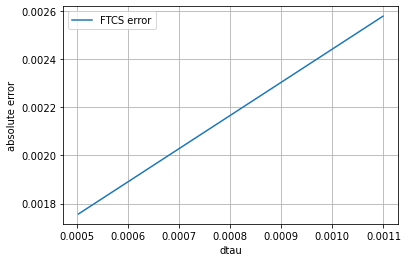

In [370]:
plt.plot(1/Tlist[71:180],t_error1[71:180],label='FTCS error')
plt.xlabel('dtau')
plt.ylabel('absolute error')
plt.legend()
plt.grid()
plt.savefig("dtau_ftcs_stable",dpi=400)
plt.show()

In [351]:
def BSdelta(S_range,K,T,r,sigma):
    delta_value=np.zeros(len(S_range))
    for i in range (len(S_range)):
        d1=(np.log(S_range[i]/K)+(r+np.square(sigma)/2)*T)/(sigma*np.sqrt(T))
        delta_value[i]=si.norm.cdf(d1)
    return delta_value

In [360]:
x_range2=np.arange(-5,8,0.01)
S_range2=np.exp(x_range2)
delta_BS=BSdelta(S_range2,K=110,T=1,r=0.04,sigma=0.3)

In [353]:
V_FTCS=FDmesh_FTCS(100,110,1,0.04,0.3,-5,8,1300,2000)[0]
V_CN=FDmesh_CN(100,110,1,0.04,0.3,-5,8,1300,2000)[0]

this setting is ok


In [354]:
x_values = np.linspace(-5, 8, 1301)
S_values=np.exp(x_values)
delta_FTCS=[]
delta_CN=[]
for i in np.arange(0,1300):
    delta_1=(V_FTCS[i+1,-1]-V_FTCS[i,-1])/(S_values[i+1]-S_values[i])
    delta_FTCS.append(delta_1)
    delta_2=(V_CN[i+1,-1]-V_CN[i,-1])/(S_values[i+1]-S_values[i])
    delta_CN.append(delta_2)

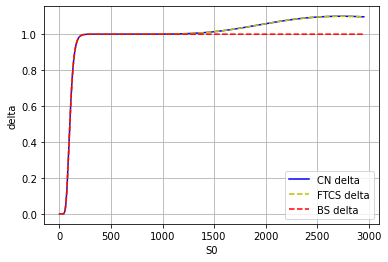

In [371]:
plt.plot(S_values[0:-1],delta_CN,'b',label='CN delta')
plt.plot(S_values[0:-1],delta_FTCS,'y--',label='FTCS delta')
plt.plot(S_values[0:-1],delta_BS,'r--',label="BS delta")
plt.xlabel('S0')
plt.ylabel('delta')
plt.legend()
plt.grid()
plt.savefig("delta",dpi=400)
plt.show()